In [1]:
import os
import scipy.io
import pandas as pd
import numpy as np
import pydicom

import matplotlib.pyplot as plt
import seaborn as sns
import imageio
from IPython.display import Image


In [2]:
path_raw = '../data/raw'
path_processed = '../data/processed'
path_CT = '/FUMPE/CT_scans/'

# CT scans (computed tomography)

"Embolia pulmonar é causada pela obstrução das artérias dos pulmões por coágulos"

https://www.youtube.com/watch?v=OLWn8OoLpBE

Para identificar se o paciente está com embolia o exame mais comum é a tomografia no qual fornece um arquivo dicom


In [3]:
def load_scan_patient(dcm_path):
    
    files = os.listdir(dcm_path)
    files.sort()
    file_dicom = [ pydicom.dcmread(dcm_path +'/'+ str(file)) for file in files]
    
    return file_dicom
    

In [4]:
PAT_001 = load_scan_patient(path_raw+path_CT+'PAT001')

In [5]:
PAT_001[0]

Dataset.file_meta -------------------------------
(0002, 0000) File Meta Information Group Length  UL: 208
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: CT Image Storage
(0002, 0003) Media Storage SOP Instance UID      UI: 1.3.6.1.4.1.9590.100.1.2.5331506912231574009137053520150588438
(0002, 0010) Transfer Syntax UID                 UI: Explicit VR Little Endian
(0002, 0012) Implementation Class UID            UI: 1.3.6.1.4.1.9590.100.1.3.100.9.4
(0002, 0013) Implementation Version Name         SH: 'MATLAB IPT 9.4'
-------------------------------------------------
(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0008) Image Type                          CS: ['ORIGINAL', 'PRIMARY', 'AXIAL', 'HELICAL']
(0008, 0012) Instance Creation Date              DA: '0'
(0008, 0013) Instance Creation Time              TM: '174444.875'
(0008, 0016) SOP Class UID                       UI: CT Image Storage
(

# Visualização CT e distribuição de pixels

In [6]:
def plot_CT_scan(file):
    fig, ax = plt.subplots(1,2,figsize=(20,5))

    ax[0].set_title("Original CT-scan")
    ax[0].imshow(file, cmap="bone")
    ax[1].set_title("Distribuição de pixels");

    sns.histplot(file.flatten(), ax=ax[1])

In [7]:
def get_pixels_hu(scan):
    image = np.stack(scan.pixel_array)
    image = image.astype(np.int16)

    image[image == -2000] = 0

    intercept = scan.RescaleIntercept
    slope = scan.RescaleSlope
    
    if slope != 1:
        image = slope * image.astype(np.float64)
        image = image.astype(np.int16)
        
    image += np.int16(intercept)
    
    return np.array(image, dtype=np.int16)

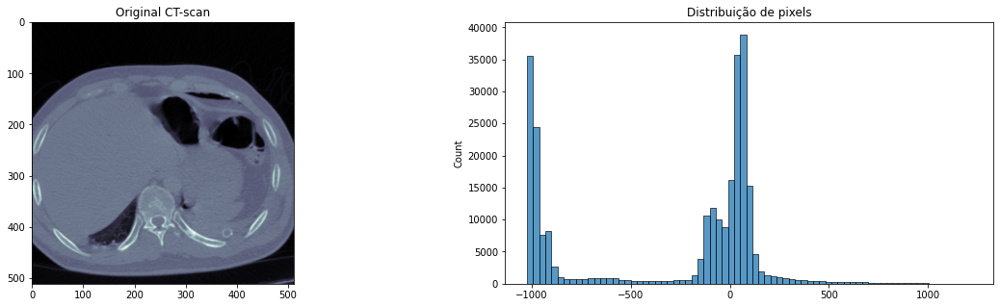

In [8]:
pixels_HU_scan = get_pixels_hu(PAT_001[0])

plot_CT_scan(pixels_HU_scan)

In [9]:
print(PAT_001[0].pixel_array.shape)

(512, 512)


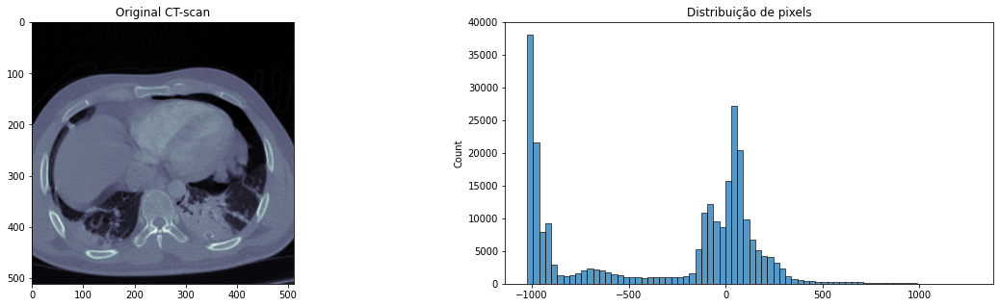

In [10]:
pixels_HU_scan = get_pixels_hu(PAT_001[50])

plot_CT_scan(pixels_HU_scan)

Para visualizar diferentes partes do scan podemos alterar essa janela de pixels. Podemos ver diferentes materias através da Hounsfield scale

https://en.wikipedia.org/wiki/Hounsfield_scale

Para diferentes tomografias ajustamos os valores de width and level values.

https://radiopaedia.org/articles/windowing-ct

No nosso caso já temos os valores a serem aplicados para conseguir visualizar a imagem, exemplo scan 1 paciente 1


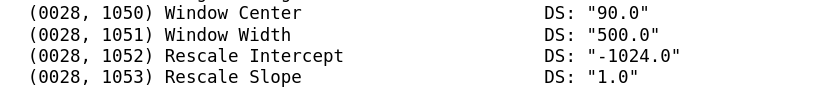

In [11]:
def change_pixels(scan, window_center, window_width, intercept, slope ):
    
    img = get_pixels_hu(scan)
    
    img_min = window_center - (window_width)/2
    img_max = window_center + (window_width)/2
    
    img[img<img_min] = img_min 
    img[img>img_max] = img_max
    
    img = (img - img_min) / (img_max - img_min)*255.0 
    
    return img

In [12]:
def get_paramas_HU(dicom):
    return [ int(dicom[('0028','1050')].value),
             int(dicom[('0028','1051')].value), 
             int(dicom[('0028','1052')].value), 
             int(dicom[('0028','1053')].value) ] 

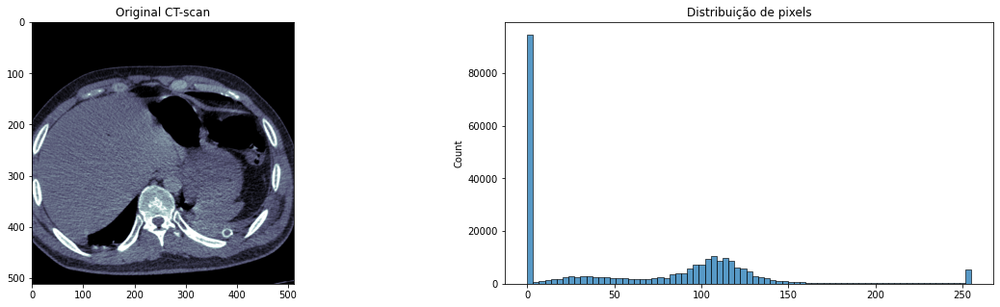

In [13]:
window_center , window_width, intercept, slope = get_paramas_HU(PAT_001[0])
patient = PAT_001[0]

image = change_pixels(patient, window_center, window_width, intercept, slope)
plot_CT_scan(image)

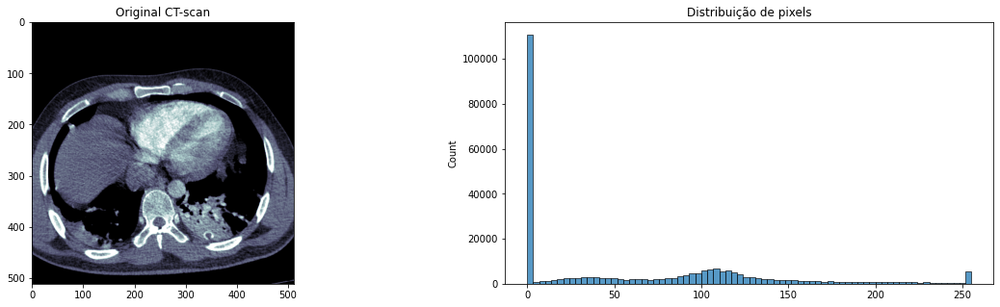

In [14]:
window_center , window_width, intercept, slope = get_paramas_HU(PAT_001[0])
patient = PAT_001[50]

image = change_pixels(patient, window_center, window_width, intercept, slope)
plot_CT_scan(image)

É possivel alterar alguns valores para ver o comportamento da imagem, mas em geral é melhor utilizar os parametros fornecidos.

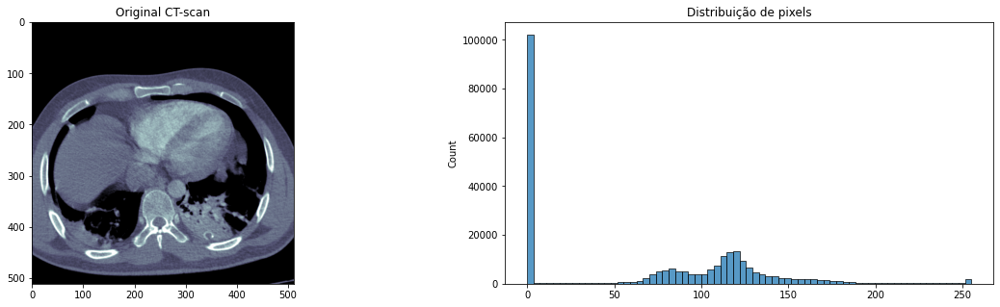

In [15]:
image = change_pixels(patient, window_center, 1000, intercept, slope)
plot_CT_scan(image)

# Visualização de alguns Scans

In [16]:
def plot_scans(scans, rows = 6, cols = 6, interval = 2):
    
    fig,ax = plt.subplots(rows,cols,figsize=[18,20])
    sum_interval = 0
    
    for i in range(rows):
        for j in range(cols):
        
            index = i*rows + j + sum_interval
            sum_interval += interval
            
            ax[i, j].set_title(f'Scan {index+1}')
            ax[i, j].imshow( scans[index] ,cmap='bone')
            ax[i, j].axis('off')
    
    plt.show()
    

In [17]:
def plot_scans_img(scans):
    
    scans_pixels = None
    
    for scan in scans:
        
        window_center , window_width, intercept, slope = get_paramas_HU(scan)
        image = change_pixels(scan, window_center, window_width, intercept, slope)
        
        if scans_pixels is None:
            scans_pixels = np.array([image])
        else:
            scans_pixels = np.append(scans_pixels, [image], axis = 0)
            
    plot_scans(scans_pixels)

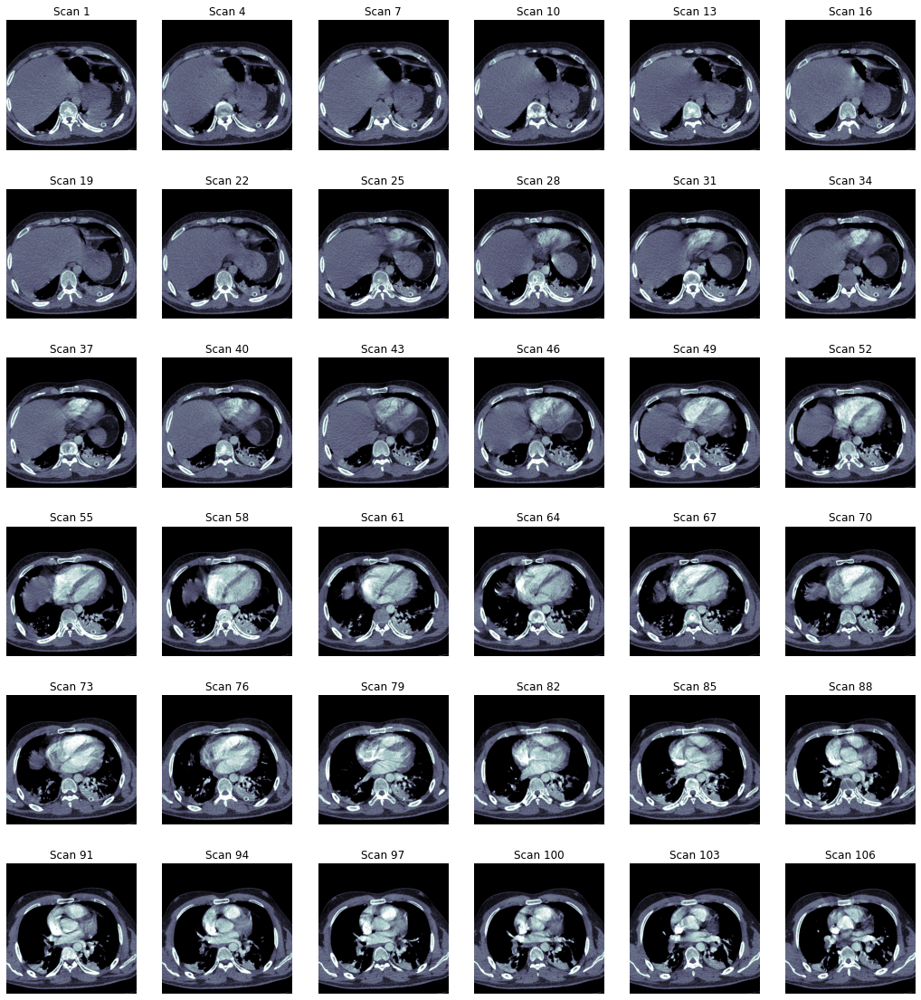

In [18]:
plot_scans_img(PAT_001)

# Visualization Gif

Vamos visualizar agora em uma gif juntando todas as imagens

In [19]:
def image_transform_hu(ct_information):
    
    window_center , window_width, intercept, slope = get_paramas_HU(ct_information) 
    image = change_pixels(ct_information, window_center, window_width, intercept, slope)
    
    return image

In [20]:
def ct_pixels(patient_ct):
    
    images = np.stack([ image_transform_hu(file) for file in patient_ct]).astype(np.uint8)
    
    return images

In [21]:
images = ct_pixels(PAT_001)

In [22]:
imageio.mimsave("../references/patiente1.gif", images, duration=0.2)

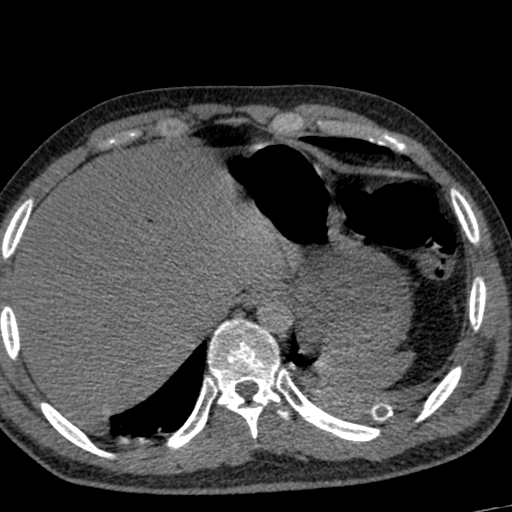

In [23]:
Image(open('../references/patiente1.gif','rb').read())

In [4]:
df_train = pd.read_csv(path_processed+'/train.csv')

In [5]:
df_train.head()

,StudyInstanceUID,SeriesInstanceUID,SOPInstanceUID,pe_present_on_image,negative_exam_for_pe,qa_motion,qa_contrast,flow_artifact,rv_lv_ratio_gte_1,rv_lv_ratio_lt_1,leftsided_pe,chronic_pe,true_filling_defect_not_pe,rightsided_pe,acute_and_chronic_pe,central_pe,indeterminate
0,6897fa9de148,2bfbb7fd2e8b,0123_c0f3cb036d06,0,0,0,0,0,0,1,1,0,0,1,0,0,0
1,6897fa9de148,2bfbb7fd2e8b,0114_f57ffd3883b6,0,0,0,0,0,0,1,1,0,0,1,0,0,0
2,6897fa9de148,2bfbb7fd2e8b,0024_41220fda34a3,0,0,0,0,0,0,1,1,0,0,1,0,0,0
3,6897fa9de148,2bfbb7fd2e8b,0023_13b685b4b14f,0,0,0,0,0,0,1,1,0,0,1,0,0,0
4,6897fa9de148,2bfbb7fd2e8b,0022_be0b7524ffb4,0,0,0,0,0,0,1,1,0,0,1,0,0,0


In [6]:
columns = ['StudyInstanceUID', 'SeriesInstanceUID', 'SOPInstanceUID', 'negative_exam_for_pe']

In [7]:
df_train = df_train[columns]

In [8]:
df_train.head()

,StudyInstanceUID,SeriesInstanceUID,SOPInstanceUID,negative_exam_for_pe
0,6897fa9de148,2bfbb7fd2e8b,0123_c0f3cb036d06,0
1,6897fa9de148,2bfbb7fd2e8b,0114_f57ffd3883b6,0
2,6897fa9de148,2bfbb7fd2e8b,0024_41220fda34a3,0
3,6897fa9de148,2bfbb7fd2e8b,0023_13b685b4b14f,0
4,6897fa9de148,2bfbb7fd2e8b,0022_be0b7524ffb4,0


In [9]:
df_train = df_train.rename(columns={"negative_exam_for_pe": "result_pe"})

In [11]:
def inverte_result(x):
    if x == 0:
        return 1
    else:
        return 0

In [12]:
df_train['result_pe'] = df_train['result_pe'].apply(inverte_result)

In [13]:
df_train = df_train.drop_duplicates('StudyInstanceUID')

In [14]:
df_train.to_csv(path_processed+'/train_apply.csv')